In [1]:
import numpy as np
import skimage
from skimage import io, filters, feature, morphology, util, transform
import matplotlib.pyplot as plt
import scipy as sp
import scipy.ndimage as nd


## Part 1 - Morphology Operations ##


### 1.1 ###

In [2]:
def show_img(img, title: str = None):
    fig, axs = plt.subplots(1, 1, constrained_layout=True, figsize=(8, 6))
    axs.imshow(img, cmap='gray')
    if title is not None:
        axs.set_title(title)
    return

In [3]:
def bottom_hat(img, structural_element):
    """
    A function that calculates bottom hat operation given a structor element and the image.
    :return:  The image minus the close operation on the structor element. structural
    """
    bottom_hat_img = morphology.closing(img, structural_element) - img
    return bottom_hat_img


def top_hat(img, structural_element):
    top_hat_img = img - morphology.opening(img, structural_element)

    return top_hat_img

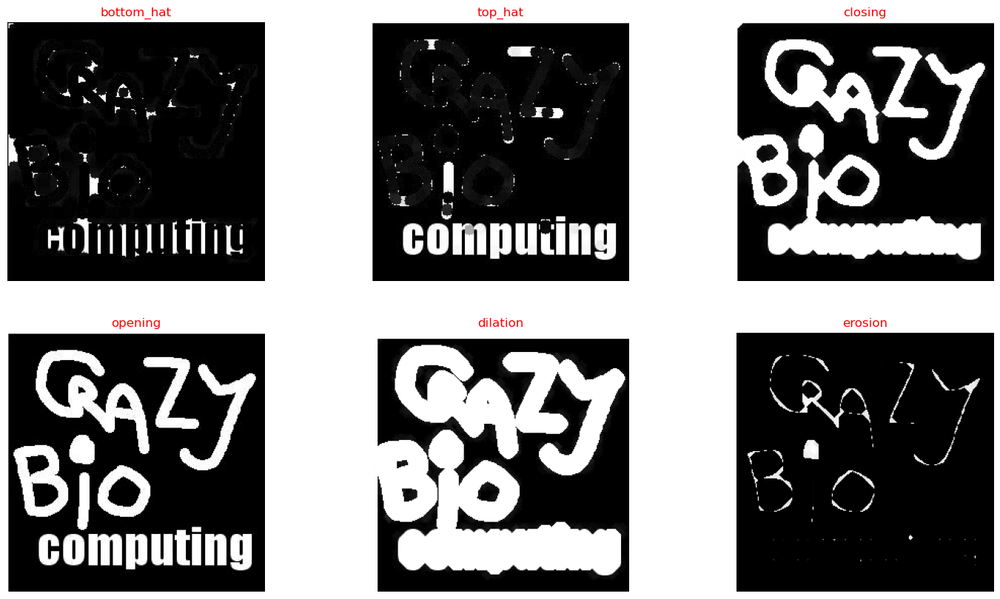

In [4]:
import random

# Loads different kind of elements structor.
structural_element = [morphology.disk(5), morphology.disk(3), morphology.star(5), morphology.diamond(5),
                      morphology.square(4), morphology.rectangle(2, 1)]
# Loads the 6-morphologies operations
morphologies_operations = [bottom_hat, top_hat, morphology.closing, morphology.opening, morphology.dilation,
                           morphology.erosion]
# Loads the image 6 times
img = io.imread('./res/crazyBioComp.jpg', as_gray=True)

# Display the results
fig, axs = plt.subplots(2, 3, figsize=(18, 10), facecolor='white')
counter = 0
for i in range(2):
    for j in range(3):
        random_stractur_elements = random.randint(0, 5)
        axs[i][j].imshow(morphologies_operations[counter](img, structural_element[random_stractur_elements]),
                         cmap='gray')
        axs[i][j].set_title((morphologies_operations[counter].__name__), color='red')
        counter += 1

for i in axs:
    for j in i:
        j.axis('off')
plt.show()

In [5]:
def create_line(is_vertical=False, length=3):
    line = None

    # if the line requested is vertical
    if is_vertical:
        line = morphology.rectangle(1, length)

    else:
        # if its horizontal
        line = morphology.rectangle(length, 1)

    return line

In [6]:
# Defines 3 structural elements:
vertical_st = create_line(True, 8)
horizontal_st = create_line(False, 8)
square_st = morphology.square(8)

Text(0.5, 1.0, 'Horizontal line result')

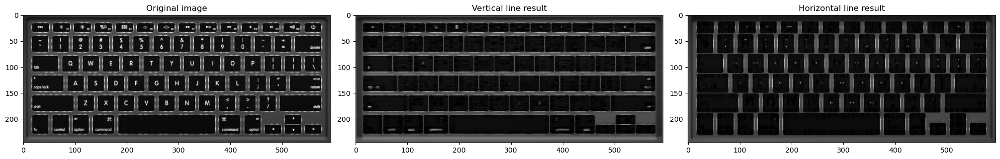

In [7]:
keyboard = io.imread('./res/keyboard.jpg', as_gray=True)
vertical_erosion = morphology.erosion(keyboard, vertical_st)
horizontal_erosion = morphology.erosion(keyboard, horizontal_st)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20, 15))
axs[0].imshow(keyboard, cmap='gray')
axs[0].set_title("Original image")

axs[1].imshow(vertical_erosion, cmap='gray')
axs[1].set_title("Vertical line result")

axs[2].imshow(horizontal_erosion, cmap='gray')
axs[2].set_title("Horizontal line result")


### Explanation ###
#### We can see that the vertical erosion will keep the rows the same, but would remove the gap between each key.
#### Also, we can see the horizontal erosion would keep the gap (vertical) between each key, but would remove the gaps between each row.

Text(0.5, 1.0, 'Binary Keyboard with threshold 0.2')

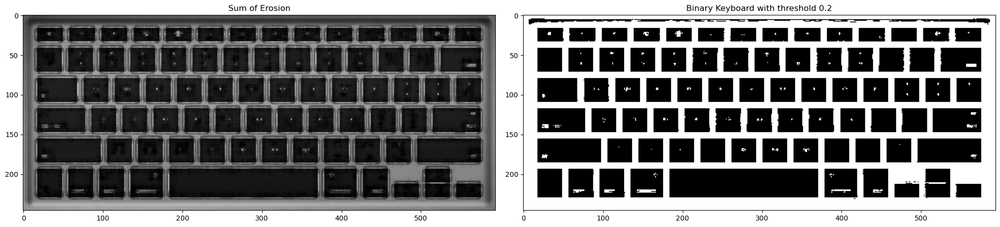

In [8]:
threshold = 0.2
# sum of the two eroded images.
keyboard_sum = vertical_erosion + horizontal_erosion
# Defines the new image
binary_keyboard = np.zeros(keyboard.shape)
# normalizing the image before calculating the pixels with respect to the threshold.
binary_keyboard[(keyboard_sum / keyboard_sum.max()) > threshold] = 1

fig, axs = plt.subplots(1, 2, constrained_layout=True, figsize=(20, 15))
axs[0].imshow(keyboard_sum, cmap='gray')
axs[0].set_title("Sum of Erosion")

axs[1].imshow(binary_keyboard, cmap='gray')
axs[1].set_title("Binary Keyboard with threshold 0.2")


### 1.2 ###

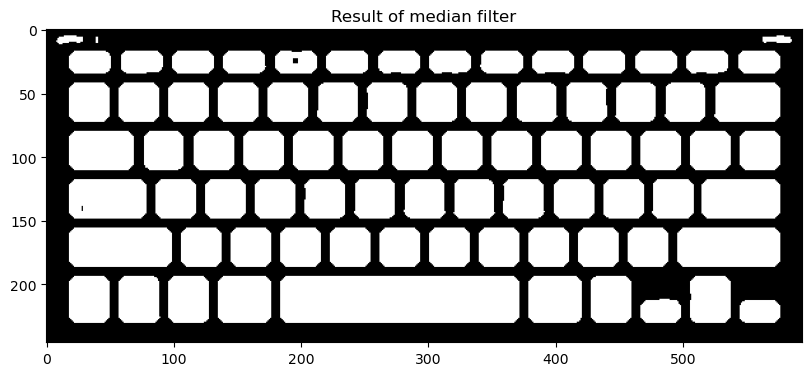

In [9]:
# Create the inverse picture of our result from the previous part.
binary_keyboard = np.zeros(keyboard.shape)
# normalizing the image before calculating the pixels with respect to the threshold.
binary_keyboard[keyboard_sum > threshold * keyboard_sum.max()] = 1
inverse_binary_keyboard = np.logical_not(binary_keyboard)

# Creates the median filter of size 8x8.
median_filter_result = filters.median(inverse_binary_keyboard, morphology.square(8))
show_img(median_filter_result, "Result of median filter")

## Explanation: ##
   #### We have learned in class that average filter would blur the image since it lowers the brightness for each pixel in the same way.
   #### To the contrary, we saw that median filter will keep the edge's differences as in the original image.


### Part 1.3—Back To Morphological Operations ###

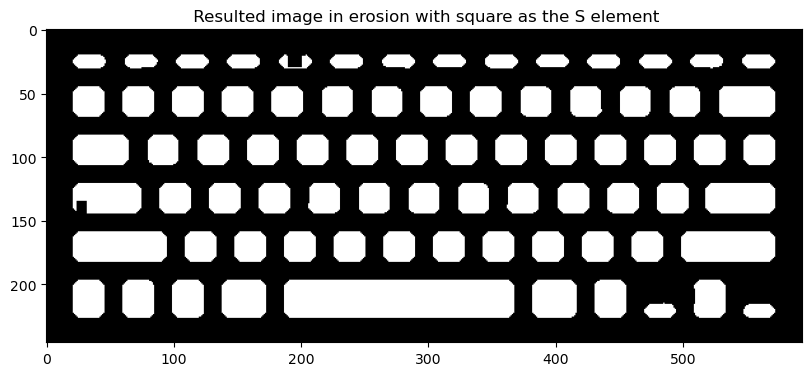

In [10]:
# Perform erosion we the square of size 8.
eroded_keyboard = morphology.erosion(median_filter_result, square_st)
show_img(eroded_keyboard, " Resulted image in erosion with square as the S element")

/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/971141350.py:2: FutureWarning: The use of this function is discouraged as its behavior may change dramatically in scikit-image 1.0. This function will be removed in scikit-image 1.0.
  cutting_keyboards = skimage.segmentation.join_segmentations(util.dtype.convert(keyboard, "uint8"),
/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/971141350.py:3: FutureWarning: The use of this function is discouraged as its behavior may change dramatically in scikit-image 1.0. This function will be removed in scikit-image 1.0.
  util.dtype.convert(eroded_keyboard, "uint8"))


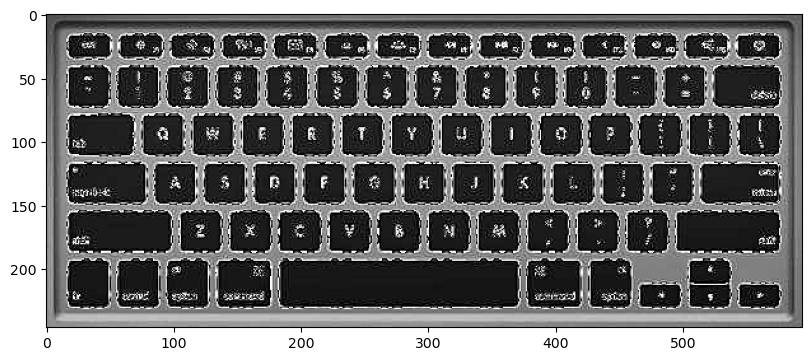

In [11]:
# Perform a cutting operation on the original image and the resulted image:
cutting_keyboards = skimage.segmentation.join_segmentations(util.dtype.convert(keyboard, "uint8"),
                                                            util.dtype.convert(eroded_keyboard, "uint8"))
cutting_keyboards = filters.unsharp_mask(cutting_keyboards)
show_img(cutting_keyboards)


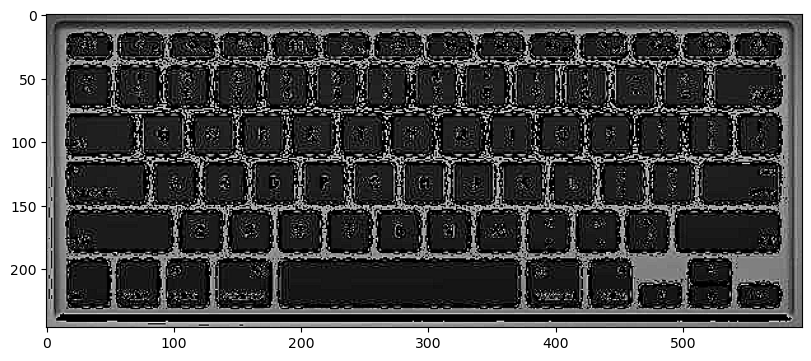

In [12]:
final_img = np.array(cutting_keyboards)
final_img[cutting_keyboards >= 0.62] = 0
show_img(filters.unsharp_mask(final_img))

### Part 2 ###


In [87]:
from numpy import double


def calc_ssd_given_pixel(pixel_x, pixel_y, template, img):
    ssd = 0

    for i in range(template.shape[0]):
        for j in range(template.shape[1]):
            # Calc the indices of the pixels
            img_index_x = pixel_x + i - 1 - template.shape[0]
            img_index_y = pixel_y + i - 1 - template.shape[1]

            # if the locations are in the img.
            if img_index_x < img.shape[1] and img_index_y < img.shape[1]:
                ssd += (template[i][j] - img[img_index_x][img_index_y]) ** 2
            else:
                ssd += 0
    return ssd


#def calc_new_image_by_ssd(img, template):
    # m,n = template.shape
    # img_row_size, img_col_size = img.shape
    # # Creates the new image
    # ssd_img  = np.zeros((img_col_size  - n + 1,img_row_size - m + 1))
    # # Convert the img, template to float images
    # template, img = template.astype(float), img.astype(float)
    # # ssd_result = feature.match_template(img, template)
    #
    # for x in range(img_col_size - n +1):
    #     for y in range(img_row_size - m + 1):
    #         ssd_img[x, y] = np.sum((img[y: y + m, x: x+m] - template)**2)
    # min_ssd = np.min(ssd_img)
    # return ssd_img, min_ssd

def calc_new_image_by_ssd(I, T):
    I = I. astype (float)
    T = T.astype (float)
    m, n = T. shape
    image_height, image_width = I. shape
    ssd = np.zeros((image_height - m + 1, image_width - n + 1))

    for x in range (image_height - m + 1):
        for y in range (image_width-n + 1):
            patch = I[x:x+m, y:y+n]
            diff = patch - T
            ssd[x, y] = np. sum (diff ** 2)

    min_ssd = np.min(ssd)
    return ssd, min_ssd



('E14', 117537.0)


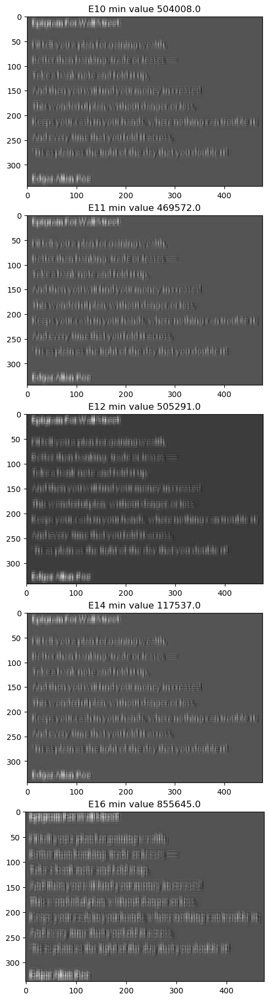

In [89]:
templates_min_ssd_value = {}
# Read image:
text_img = io.imread('./res/Text.jpg', as_gray=True)
# display image
# plt.imshow(text_img, cmap="gray")
# plt.axis('off')
# plt.show()

fig, axs = plt.subplots(5, constrained_layout=True, figsize=(20, 18))

E10, minE10 = calc_new_image_by_ssd(text_img, io.imread('./res/E10.jpg'))
templates_min_ssd_value['E10'] = minE10
axs[0].imshow(E10, cmap="gray")
axs[0].set_title(f"E10 min value {minE10}")

E11, minE11 = calc_new_image_by_ssd(text_img, io.imread('./res/E11.jpg'))
templates_min_ssd_value['E11'] = minE11
axs[1].imshow(E10, cmap="gray")
axs[1].set_title(f"E11 min value {minE11}")

E12, minE12 = calc_new_image_by_ssd(text_img, io.imread('./res/E12.jpg'))
templates_min_ssd_value['E12'] = minE12
axs[2].imshow(E12, cmap="gray")
axs[2].set_title(f"E12 min value {minE12}")

E14, minE14 = calc_new_image_by_ssd(text_img, io.imread('./res/E14.jpg'))
templates_min_ssd_value['E14'] = minE14
axs[3].imshow(E10, cmap="gray")
axs[3].set_title(f"E14 min value {minE14}")

E16, minE16 = calc_new_image_by_ssd(text_img, io.imread('./res/E16.jpg'))
templates_min_ssd_value['E16'] = minE16
axs[4].imshow(E16, cmap="gray")
axs[4].set_title(f"E16 min value {minE16}")

min_ssd_value = min(templates_min_ssd_value.items(), key=lambda x: x[1])
print(min_ssd_value)


# Explanation: #
### The minimal SSD value comes with E14 template, so it;s the most compatible template.

# Part 3 #

In [15]:
# Load the bananas image
banana_img = io.imread('./res/Bananas.jpg', as_gray=True)


In [16]:
def clipping_image_brightness(img, low_brightness=0, high_brightness=255):
    img[img < low_brightness] = low_brightness
    img[img > high_brightness] = high_brightness

    return img

In [17]:
def calculate_lap_with_param(img, a_value):
    h = np.zeros((3, 3))
    h[0, 1] = -a_value
    h[2, 1] = -a_value
    h[1, 0] = -a_value
    h[1, 2] = -a_value
    h[1, 1] = 1 + 4 * a_value

    # Perform the convolution of the image with the Laplacian for each value of a.
    img_filtered = nd.filters.convolve(img.astype(np.double), h)
    # print((img_filtered.min()), (img_filtered.max()))
    # Clipping each value that is higher than 255 or lower than 0.
    img_filtered = clipping_image_brightness(img_filtered, 0, 255)

    return img_filtered

In [18]:
def Laplacian_with_param(a_values: list, img, filter_function):
    fig, axs = plt.subplots(1, len(a_values), constrained_layout=True, figsize=(24, 8))

    for i, a in enumerate(a_values):
        # Calculates the Laplace delta filter on the image for each value of a.
        img_filtered = filter_function(img, a)
        title = f"Convolution of bananas image and Laplacian and delta with value {a}."
        axs[i].imshow(img_filtered, cmap="gray")
        axs[i].set_title(title)

    for ax in axs:
        ax.axis('off')



/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/3681955433.py:10: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  img_filtered = nd.filters.convolve(img.astype(np.double), h)


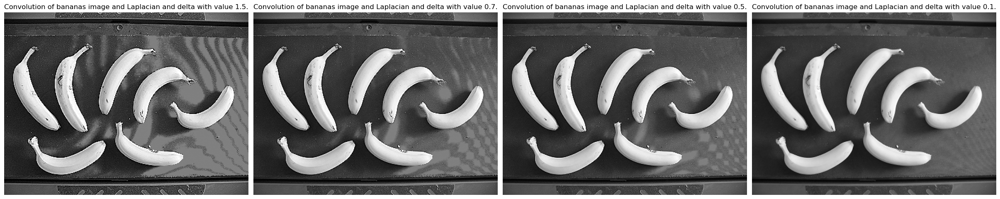

In [19]:
Laplacian_with_param([1.5, 0.7, 0.5, 0.1], banana_img, filter_function=calculate_lap_with_param)


## Best value of a ##

/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/3681955433.py:10: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  img_filtered = nd.filters.convolve(img.astype(np.double), h)


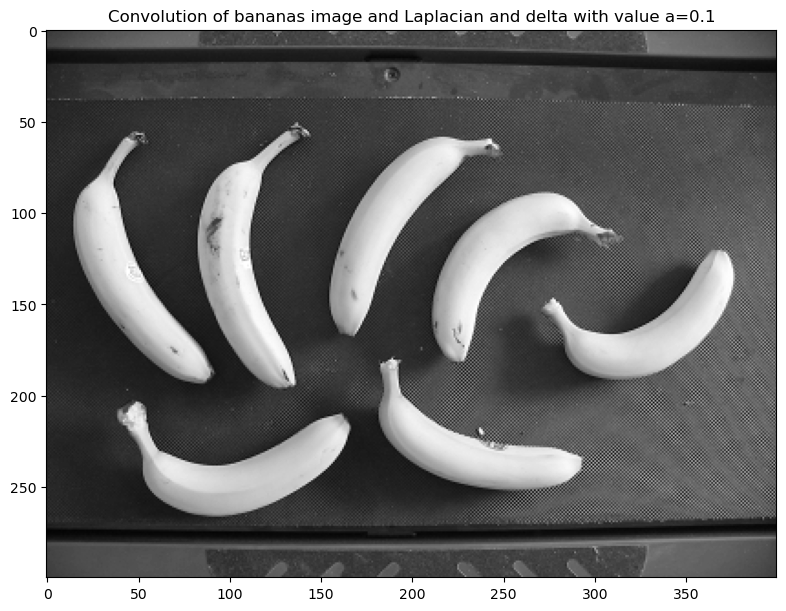

In [20]:
# In my opinion, the best a value is 0.1 since the edges remain clear and the image is sharp enough.
# Let's show the image according to a=0.1:
show_img(calculate_lap_with_param(banana_img, 0.1),
         "Convolution of bananas image and Laplacian and delta with value a=0.1")

## Adding salt & Pepper noise to the image ##

/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/3681955433.py:10: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  img_filtered = nd.filters.convolve(img.astype(np.double), h)


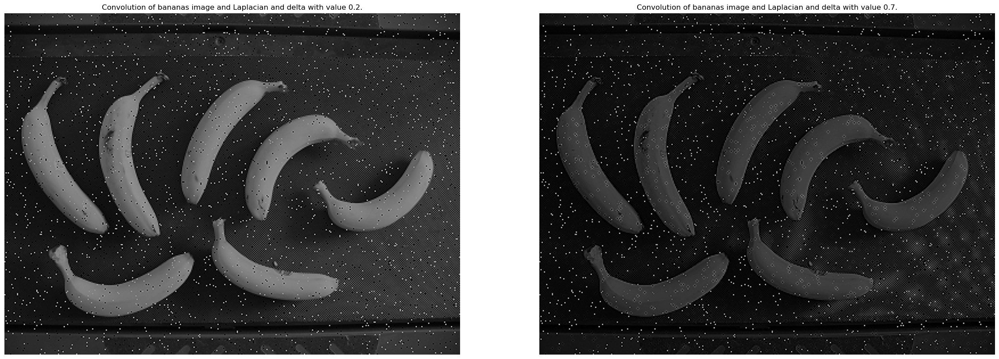

In [21]:
# Adding Salt & Pepper noise to the image with density of 3%.
a_values = [0.2, 0.7]
bananas_s_p = util.random_noise(banana_img, mode='s&p', amount=0.03)
Laplacian_with_param(a_values=a_values, img=bananas_s_p, filter_function=calculate_lap_with_param)

## Explanation : ##
### Laplacian filter is more sensitive to noises so it will calculate the second derivative of each pixel, and since salt & pepper noises are randomly shown in the picture, laplace recognize the noise as an edge detection so it keeps it - that confirms what we learned in class - Laplacian filter keeps the edge differences. ###

/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/3681955433.py:10: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  img_filtered = nd.filters.convolve(img.astype(np.double), h)


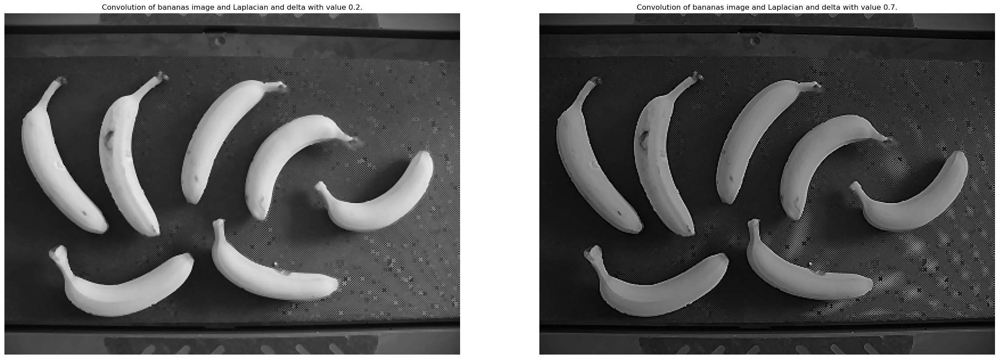

In [22]:
# I will to try to handle s&p noise with median filter:
# first let's apply median filter on the s&p image.
bananas_after_median = filters.median(bananas_s_p, morphology.square(3))
# Second, we will calculate the results of delta - laplacian with a_values = [0.2, 0.7]:
Laplacian_with_param(a_values=a_values, img=bananas_after_median, filter_function=calculate_lap_with_param)

### Now with Gaussian Noise ###

/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/3681955433.py:10: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  img_filtered = nd.filters.convolve(img.astype(np.double), h)


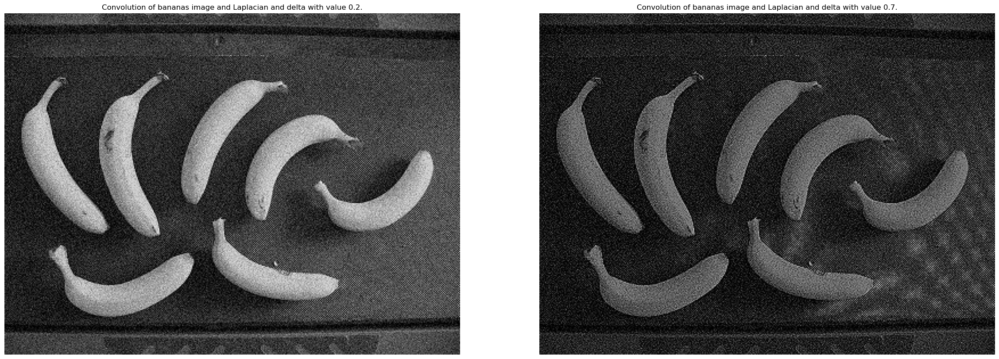

In [23]:
# Let's initialize the Gaussian paramaters
variance = 0.003
mean = 0
# Adds the noise to the banana image:
banana_gaussian_applied = util.random_noise(banana_img, mode='Gaussian', var=variance, mean=mean)

# let's see the resulted images according to the a_values:
# Laplacian_with_param(a_values=a_values, img=banana_img)
Laplacian_with_param(a_values=a_values, img=banana_gaussian_applied, filter_function=calculate_lap_with_param)

/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/3681955433.py:10: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  img_filtered = nd.filters.convolve(img.astype(np.double), h)


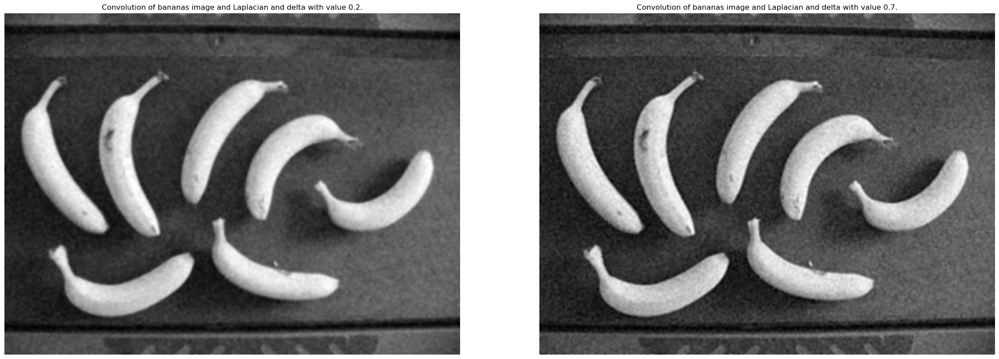

In [24]:
# Lets applied the gaussian filter - we will deal with gaussian noise with gaussian filter.
gauss_noise_filter_by_gaussian = filters.gaussian(banana_gaussian_applied)
# Second, we will calculate the results of delta - laplacian with a_values = [0.2, 0.7]:
Laplacian_with_param(a_values=a_values, img=gauss_noise_filter_by_gaussian, filter_function=calculate_lap_with_param)

In [25]:
def calculate_full_lap_with_param(i_img, i_a_value):
    h = np.full((3, 3), -i_a_value)
    h[1, 1] = 1 + 8 * i_a_value

    # Perform the convolution of the image with the Laplacian for each value of a.
    img_filtered = nd.filters.convolve(i_img.astype(np.double), h)
    # print((img_filtered.min()), (img_filtered.max()))
    # Clipping each value that is higher than 255 or lower than 0.
    img_filtered = clipping_image_brightness(img_filtered, 0, 255)

    return img_filtered

/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/2942845470.py:6: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  img_filtered = nd.filters.convolve(i_img.astype(np.double), h)


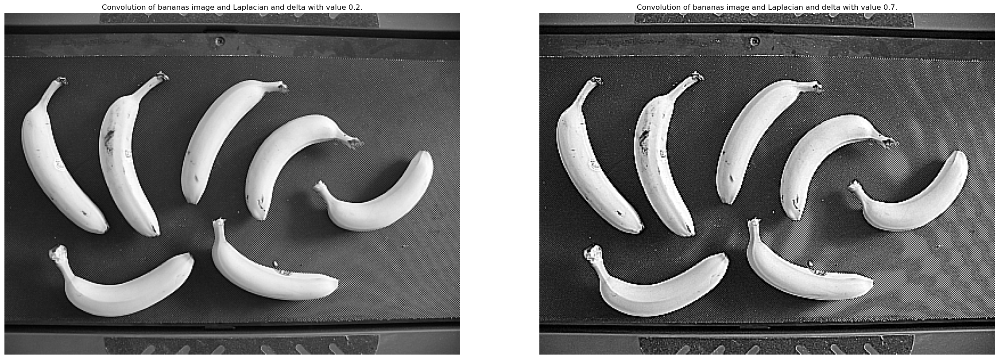

In [26]:
# Let's start with part 1:
Laplacian_with_param(a_values=a_values, img=banana_img, filter_function=calculate_full_lap_with_param)


/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/2942845470.py:6: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  img_filtered = nd.filters.convolve(i_img.astype(np.double), h)


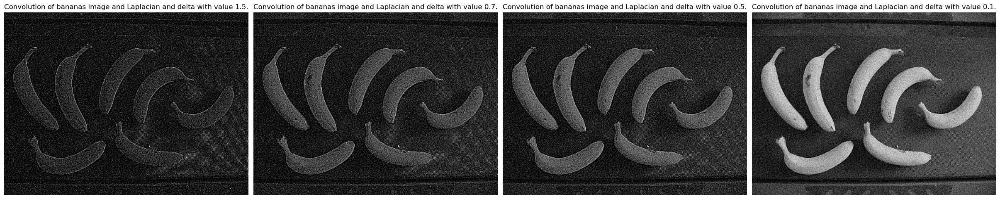

In [27]:
Laplacian_with_param(a_values=[1.5, 0.7, 0.5, 0.1], img=banana_gaussian_applied, filter_function=calculate_full_lap_with_param)

/var/folders/5r/t8tfngqn0vq37ppwh_63l5sm0000gn/T/ipykernel_12527/2942845470.py:6: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  img_filtered = nd.filters.convolve(i_img.astype(np.double), h)


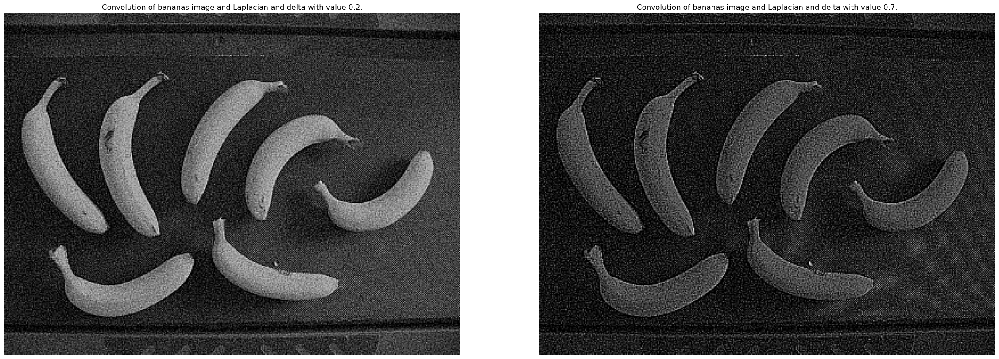

In [28]:
Laplacian_with_param(a_values=a_values, img=banana_gaussian_applied, filter_function=calculate_full_lap_with_param)

## Explanation: ##
### We can see that each pixel of the object is more sharp since the filter covers each neighbor by 4 times, so each object is more sharpened.

# Part 4 #

In [29]:
from skimage.transform import pyramids

In [30]:
# A function for building gaussian pyramid
def create_pyramid(img, pyramid_function, num_of_layers=5):
    pyramid = tuple(pyramid_function(img, downscale=2, max_layer=num_of_layers))

    return pyramid


# A function for displaying a pyramid.
def show_pyramid(pyramid):
    fig, axes = plt.subplots(1, len(pyramid), figsize=(20, 8))

    for level, image in enumerate(pyramid):
        plt.subplots_adjust(wspace=-5, hspace=5)  # Adjust the horizontal spacing between subplots
        axes[level,].imshow(image, cmap='gray', extent=[0, image.shape[0] / 2, 0, image.shape[1] / 2], aspect='auto')
        axes[level].set_title(f"Layer {level}")
        axes[level].axis('off')

    plt.tight_layout()
    plt.show()

In [31]:
def reconstruct_og_img_from_lap_pyramid(laplacian_pyramid):
    # Iterate over the pyramid in reverse order,
    # and expend (increasing the size of the filtered img and adding back the img in the layer before).
    og_img = laplacian_pyramid[-1]

    for img_layer in reversed(laplacian_pyramid[: -1]):
        img_upscale = pyramids.pyramid_expand(og_img)
        # adding the parts that in the shapes of the img_layer.
        og_img = img_layer + img_upscale[:img_layer.shape[0], :img_layer.shape[1]]

    return og_img

In [32]:
# Defines the required images.
mandril_img = io.imread('./res/Mandrill.jpg', as_gray=True)
toucan_img = io.imread('./res/toucan.tif', as_gray=True)

## Gaussian Pyramids ##


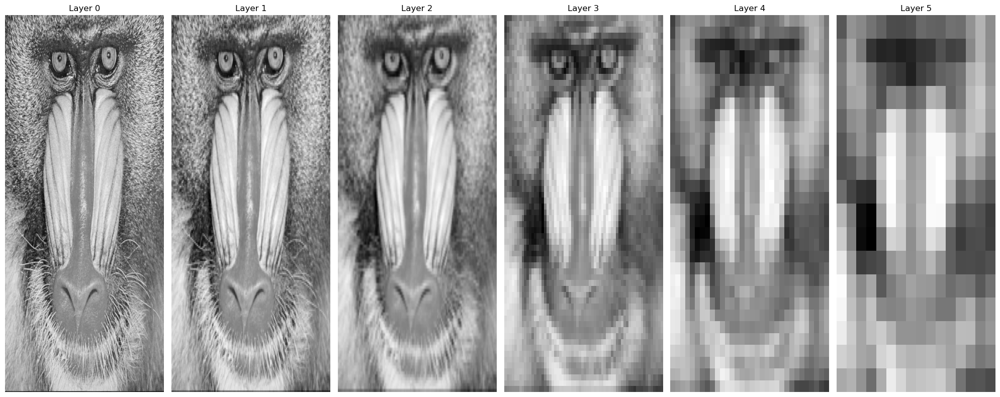

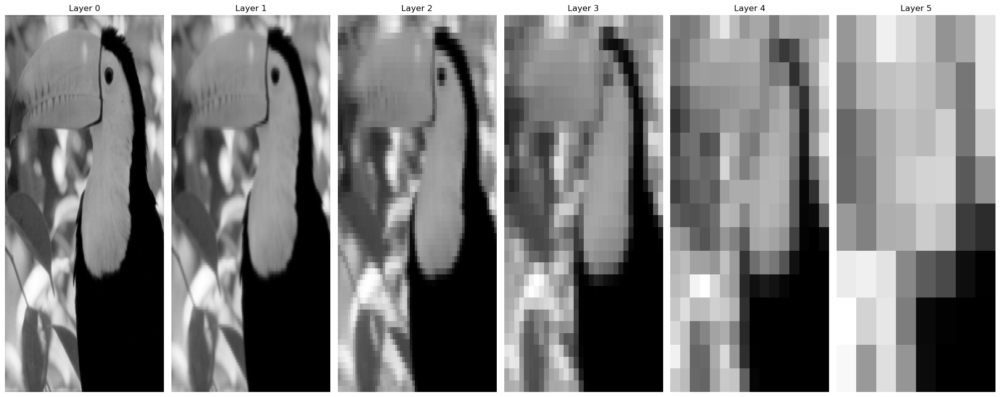

In [33]:
# Creates the mandril, toucan Gaussian pyramids
mandril_laplacian_pyramid = create_pyramid(img=mandril_img, pyramid_function=pyramids.pyramid_gaussian)
show_pyramid(mandril_laplacian_pyramid)

toucan_laplacian_pyramid = create_pyramid(img=toucan_img, pyramid_function=pyramids.pyramid_gaussian)
show_pyramid(toucan_laplacian_pyramid)

## Laplacian Pyramids ##


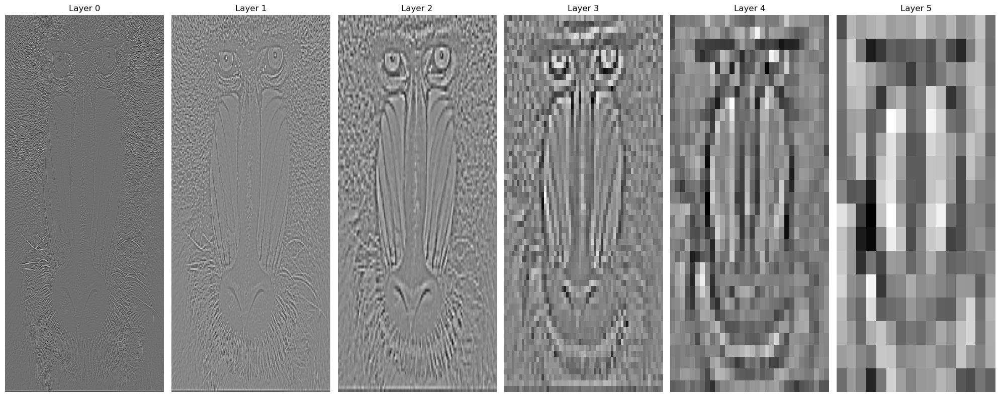

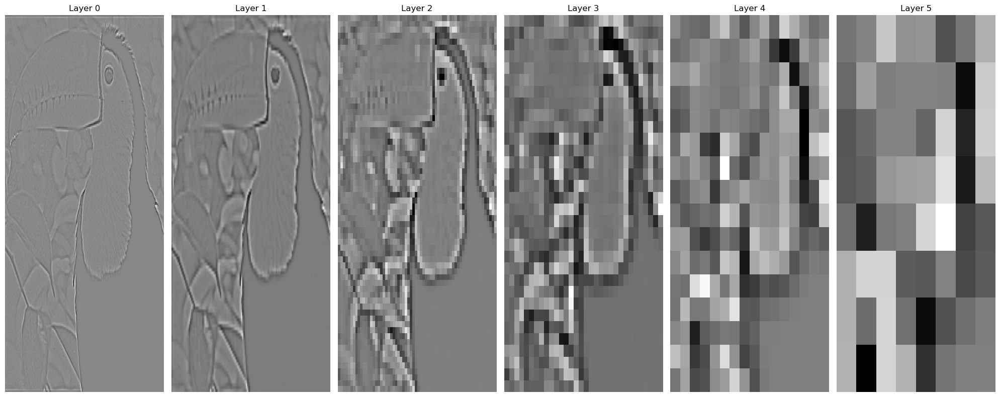

In [34]:
# Creates the mandril, toucan laplacian pyramids
mandril_laplacian_pyramid = create_pyramid(img=mandril_img, pyramid_function=pyramids.pyramid_laplacian)
show_pyramid(mandril_laplacian_pyramid)

toucan_laplacian_pyramid = create_pyramid(img=toucan_img, pyramid_function=pyramids.pyramid_laplacian)
show_pyramid(toucan_laplacian_pyramid)

## Explanation: ##
### we can see that since the toucan image has more edges, the laplacian pyramid maintains better the shape of the object (bird), but since the fur of the object (monkey) is much darker, laplacian struggle to maintain the shape of the object from early stage.

(Text(0.5, 1.0, 'Reconstructed image'), (-0.5, 255.5, 255.5, -0.5))

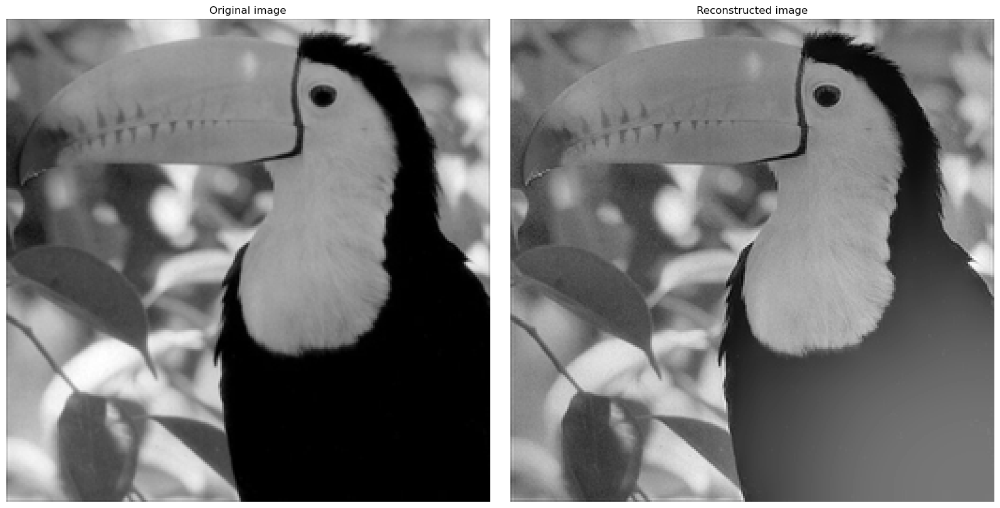

In [35]:
fig, axs = plt.subplots(1, 2, constrained_layout=True, figsize=(16, 8))

axs[0].imshow(toucan_img, cmap="gray")
axs[0].set_title("Original image"), axs[0].axis('off')

axs[1].imshow(reconstruct_og_img_from_lap_pyramid(toucan_laplacian_pyramid), cmap="gray")
axs[1].set_title("Reconstructed image"), axs[1].axis('off')

In [36]:
# Functions for helping to merge two pyramids together.
def merge_pyramids_layers(pyramid1, pyramid2):
    merged_layers = [layer1 + layer2 for layer1, layer2 in zip(pyramid1, pyramid2)]

    return merged_layers


def increase_img_quality(pyramid1, pyramid2):
    merged_pyramid = merge_pyramids_layers(pyramid1, pyramid2)

    return reconstruct_og_img_from_lap_pyramid(merged_pyramid)

(Text(0.5, 1.0, 'Merged focus 1,2 images'), (-0.5, 713.5, 475.5, -0.5))

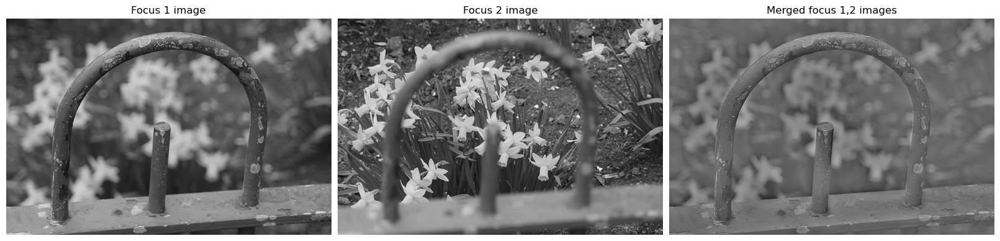

In [37]:
# Defines the required images.
focus1 = io.imread('./res/focus1.tif', as_gray=True)
focus1_pyramid = create_pyramid(img=focus1, pyramid_function=pyramids.pyramid_laplacian, num_of_layers=4)

focus2 = io.imread('./res/focus2.tif', as_gray=True)
focus2_pyramid = create_pyramid(img=focus1, pyramid_function=pyramids.pyramid_laplacian, num_of_layers=4)

merge_focuses = increase_img_quality(focus1_pyramid, focus2_pyramid)

# Displaying results
fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(16, 8))

axs[0].imshow(focus1, cmap="gray")
axs[0].set_title("Focus 1 image"), axs[0].axis('off')

axs[1].imshow(focus2, cmap="gray")
axs[1].set_title("Focus 2 image"), axs[1].axis('off')

axs[2].imshow(merge_focuses, cmap="gray")
axs[2].set_title("Merged focus 1,2 images"), axs[2].axis('off')


## Explanation : ##
### The function works since the images have the same dimensions.
 ### Also, since we add to each pixel the light brightness of the other, we can merge the picture into ine picture. ###


# Part 5

In [38]:
from skimage.transform import frt2

SyntaxError: invalid syntax (2456340224.py, line 1)